## Data Exploration

### 1. Build Data Frame from the source files

In [26]:
import os
import random
import shutil

from pathlib import Path
import urllib

import numpy as np
import pandas as pd
from PIL import Image
import matplotlib.pyplot as plt

from fastai.vision import *

import warnings
warnings.filterwarnings('ignore')

In [27]:
path = Path('../input/food-101/food-101/food-101')
path_meta = path/'meta'
path_images = path/'images'

In [28]:
path_meta

PosixPath('../input/food-101/food-101/food-101/meta')

In [29]:
def build_data_frame(path_name, file_name, img_format = 'jpg'):
    """
    build_data_frame input the path and file name, the function will return the dataframe with two columns:
    ['label'] : image label
    ['image_file'] : image file name with directory information
    input paramters:
    path_name : path 
    file_name : file name, string
    img_format : default format is jpg
    
    return dataframe
    """
    path_file = path_name/file_name
    file_df = pd.read_csv(path_file,delimiter='/', header=None, names=['label', 'image_file'])
    file_df['image_file'] = file_df['label'].astype(str) + '/' + file_df['image_file'].astype(str) + '.'+img_format
    
    return file_df

In [30]:
train_df = build_data_frame(path_meta, 'train.txt')
test_df = build_data_frame(path_meta, 'test.txt')

In [31]:
train_df.head()

,label,image_file
0,apple_pie,apple_pie/1005649.jpg
1,apple_pie,apple_pie/1014775.jpg
2,apple_pie,apple_pie/1026328.jpg
3,apple_pie,apple_pie/1028787.jpg
4,apple_pie,apple_pie/1043283.jpg


In [32]:
train_df.shape

(75750, 2)

In [33]:
test_df.head()

,label,image_file
0,apple_pie,apple_pie/1011328.jpg
1,apple_pie,apple_pie/101251.jpg
2,apple_pie,apple_pie/1034399.jpg
3,apple_pie,apple_pie/103801.jpg
4,apple_pie,apple_pie/1038694.jpg


In [34]:
test_df.shape

(25250, 2)

Detailed information about this dataset can be found at their website https://www.vision.ee.ethz.ch/datasets_extra/food-101/

- This dataset contains food of 101 classes, each class has 1000 images totalling 101,000 images.
- Each class has 250 manually reviewed test images and 750 training images.
- The training images were not cleaned on purpose, so still contain some amount of noise (mostly in the form of intense colors and sometimes wrong labels.

### 2. Explore Data Structure and Files

In [35]:
# list of all the 101 classes
os.listdir(path_images)

['hamburger',
 'ice_cream',
 'club_sandwich',
 'risotto',
 'hot_and_sour_soup',
 'waffles',
 'greek_salad',
 'cup_cakes',
 'steak',
 'paella',
 'escargots',
 'deviled_eggs',
 'clam_chowder',
 'eggs_benedict',
 'seaweed_salad',
 'hummus',
 'sushi',
 '.DS_Store',
 'beignets',
 'lasagna',
 'pancakes',
 'baklava',
 'guacamole',
 'grilled_salmon',
 'mussels',
 'ramen',
 'caesar_salad',
 'lobster_bisque',
 'pad_thai',
 'macarons',
 'edamame',
 'filet_mignon',
 'samosa',
 'macaroni_and_cheese',
 'bibimbap',
 'crab_cakes',
 'ravioli',
 'omelette',
 'dumplings',
 'chicken_wings',
 'red_velvet_cake',
 'foie_gras',
 'peking_duck',
 'cheese_plate',
 'fried_rice',
 'cannoli',
 'tuna_tartare',
 'creme_brulee',
 'french_fries',
 'onion_rings',
 'grilled_cheese_sandwich',
 'chicken_quesadilla',
 'strawberry_shortcake',
 'french_onion_soup',
 'sashimi',
 'baby_back_ribs',
 'garlic_bread',
 'poutine',
 'pho',
 'carrot_cake',
 'bruschetta',
 'nachos',
 'croque_madame',
 'caprese_salad',
 'chocolate_mouss

In [36]:
# number of classes
image_categories = os.listdir(path_images)
image_categories.remove('.DS_Store')
print(len(image_categories))

101


In [37]:
# meta folder files
os.listdir(path_meta)

['test.json',
 'test.txt',
 'train.json',
 'labels.txt',
 'train.txt',
 'classes.txt']

### 3. Explore the Images

#### 3.1 Visualize random image from each class

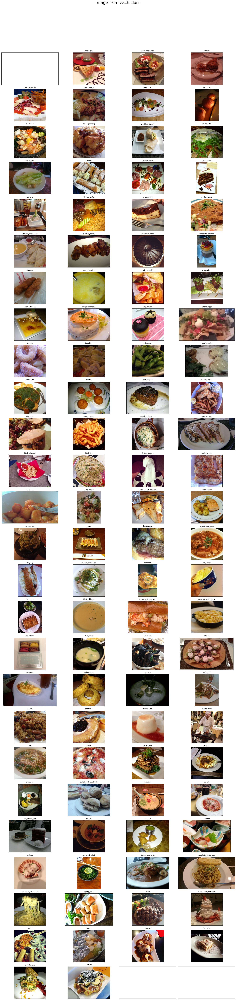

In [38]:
# In order to show big enough images of each class, 4 images each row
rows = 26
cols = 4
fig, ax = plt.subplots(rows, cols, figsize=(25,100))
fig.suptitle("Image from each class", y=1.05, fontsize=30) # Adding  y=1.05, fontsize=24 helped me fix the suptitle overlapping with axes issue
data_dir = path_images
foods_sorted = sorted(os.listdir(data_dir))
food_id = 0
for i in range(rows):
  for j in range(cols):
    try:
      food_selected = foods_sorted[food_id] 
      food_id += 1
    except:
      break
    if food_selected == '.DS_Store':
        continue
    food_selected_images = os.listdir(os.path.join(data_dir,food_selected)) # returns the list of all files present in each food category
    food_selected_random = np.random.choice(food_selected_images) # picks one food item from the list as choice, takes a list and returns one random item
    img = plt.imread(os.path.join(data_dir,food_selected, food_selected_random))
    ax[i][j].imshow(img)
    ax[i][j].set_title(food_selected, pad = 10)
    
plt.setp(ax, xticks=[],yticks=[])
plt.tight_layout()

#### 3.2 Visualize Images Within Each Class

We are going to use Fast.ai Data Block API. The data block API lets you customize the creation of a Databunch by isolating the underlaying parts of that process in separate blocks, mainly:
1. Where are the inputs and how to create them?
2. How to split the data into a training and validation sets?
3. How to label the inputs?
4. What transforms to apply?
5. How to add a test set?
6. How to wrap in dataloaders and create the DataBunch?

reference: http://docs.fast.ai/data.block

Let's first build our Data Block from the dataframe we created

In [39]:
# set batch size
bs = 64
# creat databunch using Data Block API
train_data = ImageList.from_df(df=train_df,path=path_images, cols=1)\
              .split_by_rand_pct(0.2)\
              .label_from_df(cols=0)\
              .transform(get_transforms(), size=224)\
              .databunch(bs=bs)

train_data

ImageDataBunch;

Train: LabelList (60600 items)
x: ImageList
Image (3, 224, 224),Image (3, 224, 224),Image (3, 224, 224),Image (3, 224, 224),Image (3, 224, 224)
y: CategoryList
apple_pie,apple_pie,apple_pie,apple_pie,apple_pie
Path: ../input/food-101/food-101/food-101/images;

Valid: LabelList (15150 items)
x: ImageList
Image (3, 224, 224),Image (3, 224, 224),Image (3, 224, 224),Image (3, 224, 224),Image (3, 224, 224)
y: CategoryList
beef_tartare,ice_cream,ravioli,sashimi,oysters
Path: ../input/food-101/food-101/food-101/images;

Test: None

We are going to build two functions, one to build all same class images via Data Block API, one to show images of each class

In [40]:
np.random.seed(101)
#function to show images from "class_name"
def show_class_images(class_name, row_number = 4, fig_size = (15,15)):
    
    class_path = path_images/class_name
    fnames = get_image_files(class_path)
    pat = r'/([^/]+)/\d+.jpg$'
    class_data = ImageDataBunch.from_name_re(class_path, fnames, pat, ds_tfms=get_transforms(), size=224, bs=bs
                                  ).normalize(imagenet_stats)
    print('Class Name: ', class_name)
    class_data.show_batch(rows=row_number, figsize=fig_size)
    
    return

Class Name:  baklava


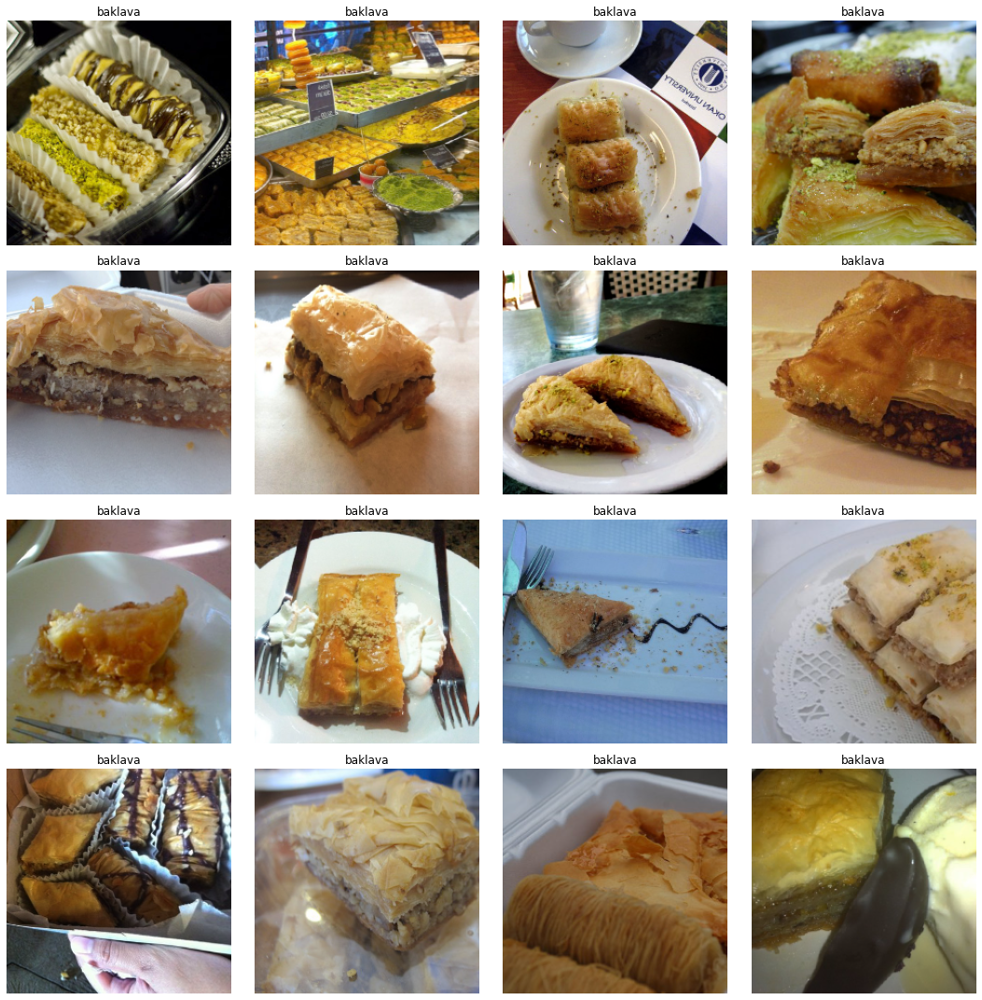

In [41]:
# show image from baklava class
show_class_images(train_data.classes[2])

Class Name:  breakfast_burrito


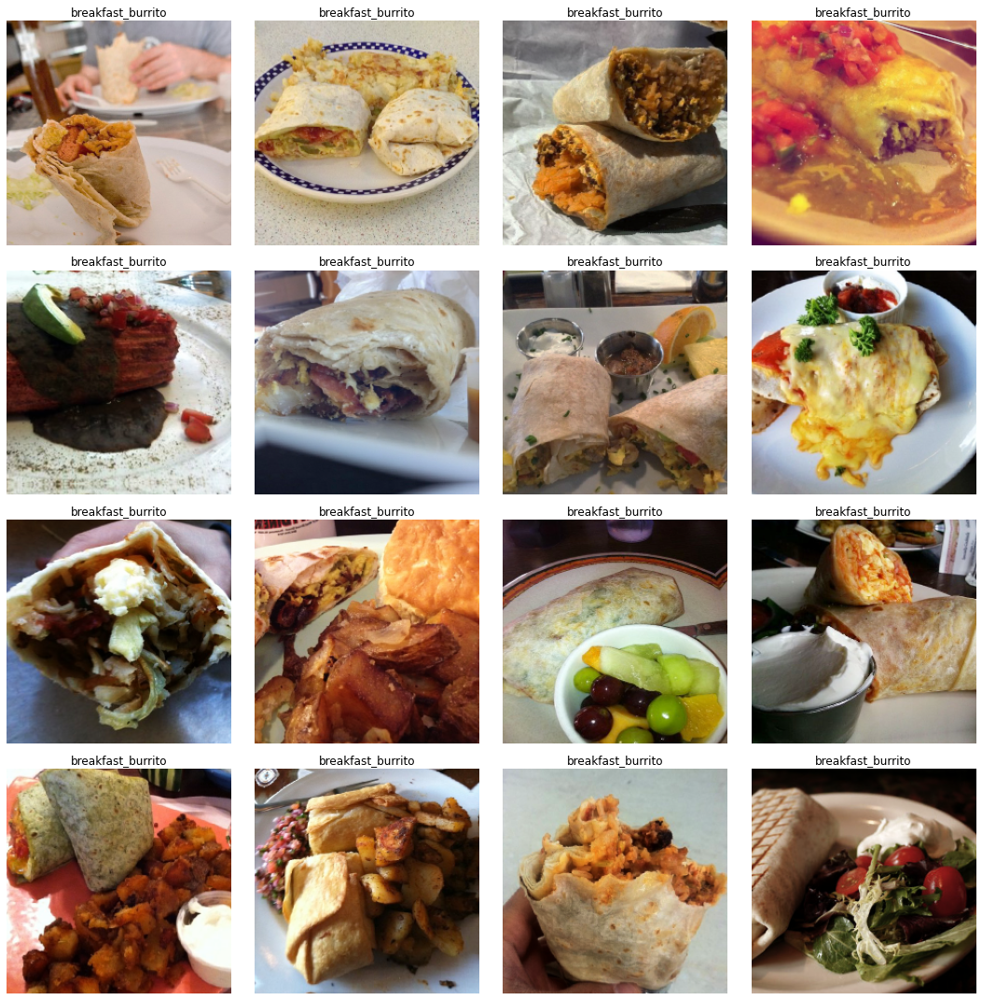

In [42]:
#show images from breakfast burrito class
show_class_images(train_data.classes[9])

### 4. Image Augmentation

Data augmentation is a strategy to increase the diversity of data available for model training, without having to collect new data. For images, data augmentation consists of many techniques, such as cropping, padding, flipping (h or v), warping, brightness and contrast changing and so on. 

For the actual model training, I will use random transformations which randomly apply flip, warp, rotate, zoom, lighting, contrast to images. But for exploration purposes, I will try to visualize the transformations and visually show how transformations work.

#### 4.1 Visualize Image Transformation

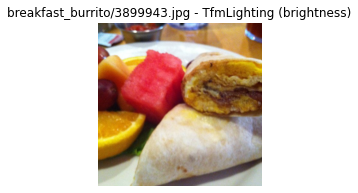

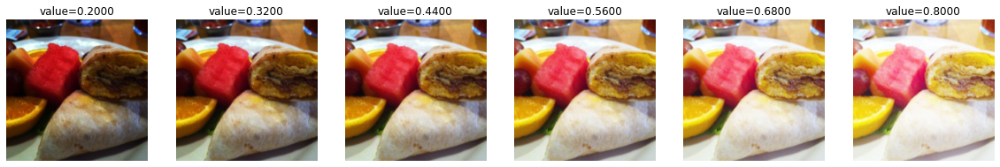

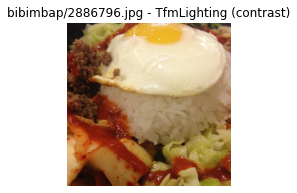

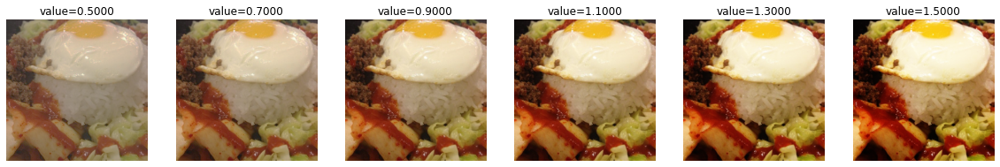

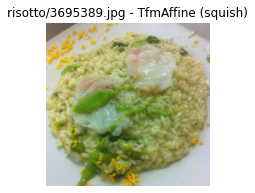

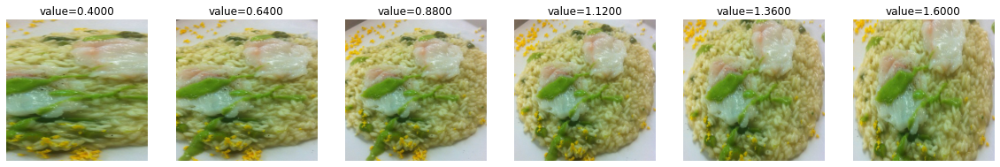

In [44]:
# Visualize transforms separately on a random image
def display_transform(img_df, img_dir_path, transform, min_value, max_value, columns, width, height):
    # Sample an image from the whole dataset
    sample_file_name = img_df.sample(1)['image_file'].iloc[0]
    img = open_image(img_dir_path/sample_file_name)
    img.show(title=sample_file_name + ' - ' + str(transform))
    
    fig, axes = plt.subplots(1, columns, figsize=(width,height))
    
    # Visualize different levels of variation
    for value, axis in zip(np.linspace(min_value, max_value, columns), axes):
        # open a new image, cause old image has been transformed
        img = open_image(img_dir_path/sample_file_name)
        transform(img, value).show(ax=axis, title=f'value={value:.4f}')
        
display_transform(train_df, path_images, brightness, 
                  min_value = 0.5 - 0.3, max_value = 0.5 + 0.3, columns = 6, width = 20, height = 14)
display_transform(train_df, path_images, contrast, 
                  min_value = 1 - 0.5, max_value = 1 + 0.5, columns = 6, width = 20, height = 14)
display_transform(train_df, path_images, squish,
                  min_value = 1 - 0.6, max_value = 1 + 0.6, columns = 6, width = 20, height = 14)

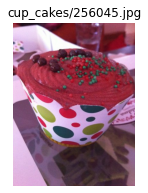

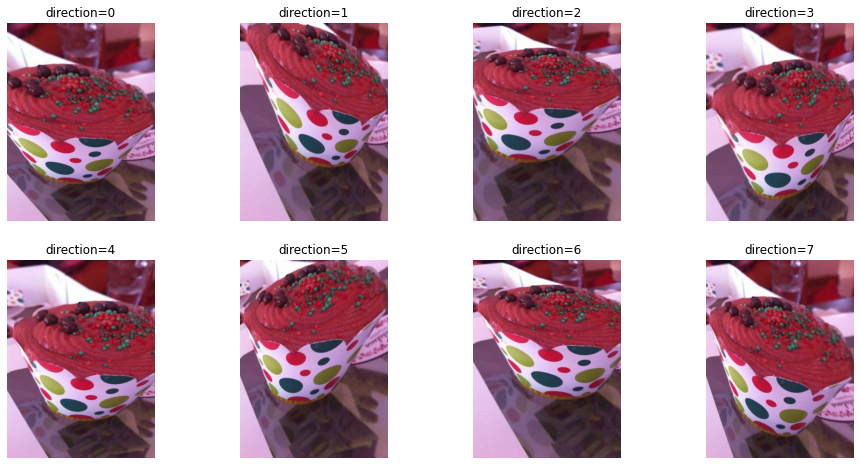

In [45]:
# Displaying skew requires a different logic than the other transforms
def display_skew_transform(img_df, img_dir_path, rows=2, columns=4, width=16, height=8):
    sample_file_name = img_df.sample(1)['image_file'].iloc[0]
    img = open_image(img_dir_path/sample_file_name)
    img.show(title=sample_file_name)

    fig, axs = plt.subplots(rows, columns, figsize=(width,height))
    for i, ax in enumerate(axs.flatten()):
        # open a new image, cause old image has been transformed
        open_image(img_dir_path/sample_file_name).skew(i, 0.7).show(ax=ax, title=f'direction={i}')

display_skew_transform(train_df, path_images,)

#### 4.2 Visualize Combination of Transformations

In [46]:
# Define transforms used for data augmentation
image_transforms = get_transforms(
    max_rotate=15,
    max_zoom=1.3,
    max_lighting=0.4,
    max_warp=0.4,
    xtra_tfms=[
        brightness(change=(0.5-0.3, 0.5+0.3), p=0.75),
        contrast(scale=(1-0.5, 1+0.5), p=0.75),
        squish(scale=(1-0.5, 1+0.5), p=0.75),
        skew(direction=(0, 7), magnitude=random.randint(0,6)/10, p=0.75),
    ]
)

In [49]:
def image_with_tfms(class_name,padding_mode, row_number = 4, fig_size = (10,10)):
    class_path = path_images/class_name
    fnames = get_image_files(class_path)
    pat = r'/([^/]+)/\d+.jpg$'
    class_data = ImageDataBunch.from_name_re(class_path, fnames, pat, \
                                             ds_tfms=image_transforms, size=224, \
                                             padding_mode=padding_mode,\
                                             bs=bs)\
                                            .normalize(imagenet_stats)
    print('Class Name: ', class_name)
    class_data.show_batch(rows=row_number, figsize=fig_size)
    
    return


Class Name:  bibimbap


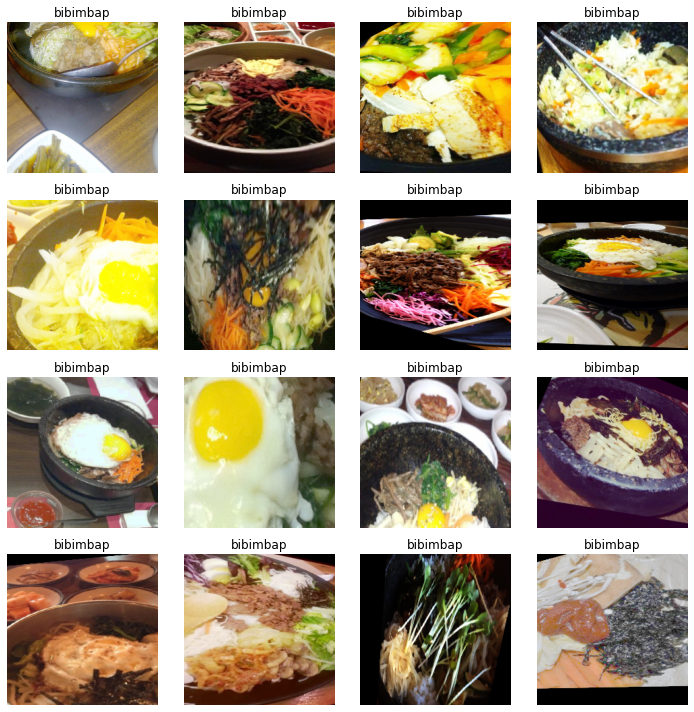

In [51]:
image_with_tfms(train_data.classes[7],padding_mode = 'zeros')